# # Chord Progressions Notebook
En este notebook:

1. Generamos archivos .mid con `generate_progression.py` en TODAS las tonalidades (p. ej. "A-1-..." o "C#-5-...").
2. Convertimos esos .mid a .wav con Timidity usando `audio_conversion.py`.
3. Creamos .jams parseando el nombre de cada .mid para extraer:
   - Nota y octava (p. ej. "A-1"),
   - Progresión en numerales romanos (p. ej. "I-vi-IV-V"),
   - Índice final, p. ej. "3".

---

## 1. Imports y Configuración

In [1]:
import sys
import random
from pathlib import Path
import json

# Ajustar la ruta para que Python reconozca 'src'
PROJECT_ROOT = Path.cwd().parent
if str(PROJECT_ROOT) not in sys.path:
    sys.path.append(str(PROJECT_ROOT))

from src.config import MIDI_DIR, WAV_DIR, JAMS_DIR, DEFAULT_TEMPO
from src.generate_progression import generate_progression
from src.audio_conversion import convert_all_mid_in_folder
from src.jams_creation import create_jams_for_folder

print("MIDI_DIR =", MIDI_DIR)
print("WAV_DIR  =", WAV_DIR)
print("JAMS_DIR =", JAMS_DIR)
print("DEFAULT_TEMPO =", DEFAULT_TEMPO)


MIDI_DIR = /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi
WAV_DIR  = /home/cepatinog/MIR/final_project/chord_progression_generator/data/wav
JAMS_DIR = /home/cepatinog/MIR/final_project/chord_progression_generator/data/jams
DEFAULT_TEMPO = 60


## 2. Generar Progresiones .mid


Cada una se expandirá en las diferentes octavas y tonalidades, generando múltiples .mid en `data/midi/...`.

In [2]:
# Todos los tipos de acordes posibles
prog_all_1 = "i,min-ii,maj-iii,dim-IV,aug"
prog_all_2 = "V,min6-vi,maj6-vii,min7-I,minmaj7"
prog_all_3 = "ii,maj7-iii,7-IV,dim7-V,hdim7"
prog_all_4 = "vi,sus2-vii,sus4-I,maj-vi,min"

name_all_1 = "i,min-ii,maj-iii,dim-IV,aug"
name_all_2 = "V,min6-vi,maj6-vii,min7-I,minmaj7"
name_all_3 = "ii,maj7-iii,7-IV,dim7-V,hdim7"
name_all_4 = "vi,sus2-vii,sus4-I,maj-vi,min"

generate_progression(prog_all_1, name_all_1, MIDI_DIR, DEFAULT_TEMPO)
generate_progression(prog_all_2, name_all_2, MIDI_DIR, DEFAULT_TEMPO)
generate_progression(prog_all_3, name_all_3, MIDI_DIR, DEFAULT_TEMPO)
generate_progression(prog_all_4, name_all_4, MIDI_DIR, DEFAULT_TEMPO)

# Rutas de carpetas generadas
midi_folder_all_1 = MIDI_DIR / name_all_1
midi_folder_all_2 = MIDI_DIR / name_all_2
midi_folder_all_3 = MIDI_DIR / name_all_3
midi_folder_all_4 = MIDI_DIR / name_all_4

Generated progression 'i,min-ii,maj-iii,dim-IV,aug' -> folder: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/i,min-ii,maj-iii,dim-IV,aug
Generated progression 'V,min6-vi,maj6-vii,min7-I,minmaj7' -> folder: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/V,min6-vi,maj6-vii,min7-I,minmaj7
Generated progression 'ii,maj7-iii,7-IV,dim7-V,hdim7' -> folder: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/ii,maj7-iii,7-IV,dim7-V,hdim7
Generated progression 'vi,sus2-vii,sus4-I,maj-vi,min' -> folder: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/vi,sus2-vii,sus4-I,maj-vi,min


In [3]:
def parse_mid_filename(base_name: str):
    parts = base_name.split("-", 2)
    if len(parts) < 3:
        print(f"[WARN] {base_name} no tiene formato esperado (nota-oct-progresion-idx).")
        return None

    note_str = parts[0]
    oct_str = parts[1]
    remainder = parts[2]

    remainder_parts = remainder.rsplit("-", 1)
    if len(remainder_parts) < 2:
        print(f"[WARN] '{base_name}' no tiene '-<index>' al final.")
        return None

    progression_str = remainder_parts[0]  # ej: "i,min-ii,maj-iii,dim-IV,aug"
    idx_str = remainder_parts[1]

    try:
        inversion_index = int(idx_str)
    except:
        print(f"[WARN] Index '{idx_str}' no es entero.")
        inversion_index = 0

    raw_tokens = progression_str.split("-")
    roman_sequence = [tok for tok in raw_tokens if "," in tok]
    split_sequence = [tuple(s.split(",")) for s in roman_sequence]
    base_chords = [x[0] for x in split_sequence]
    suffixes = [x[1] for x in split_sequence]

    return {
        "note": note_str,
        "octave": oct_str,
        "base_chords": base_chords,
        "suffixes": suffixes,
        "inversion_index": inversion_index
    }


from src.jams_creation import create_jams_file

def parse_and_create_jams_in_folder(folder: Path):
    """
    1) lee durations.json
    2) itera cada .mid en la carpeta
       - parsea nombre
       - construye roman_sequence
       - llama create_jams_file con duraciones
    """
    durations_path = folder / "durations.json"
    if durations_path.exists():
        with open(durations_path, "r") as f:
            durations_dict = json.load(f)
    else:
        durations_dict = {}

    mid_files = list(folder.rglob("*.mid"))
    if not mid_files:
        print(f"No hay .mid en => {folder}")
        return

    for mf in mid_files:
        base_name = mf.stem  # e.g. "A-2-rand3_ii-V-I_dim7_min7_min-1"
        parsed = parse_mid_filename(base_name)
        if not parsed:
            continue

        base_chords = parsed["base_chords"]
        suffixes    = parsed["suffixes"]
        if len(base_chords) != len(suffixes):
            print(f"[WARN] chords != suffixes in {mf.name}")
            continue

        # p.ej. ['ii,dim7','V,min7','I,min']
        roman_sequence = [f"{g},{s}" for g,s in zip(base_chords, suffixes)]

        # Duraciones
        durations = durations_dict.get(f"{base_name}.mid", None)

        # Tonalidad
        note_tonality = parsed["note"]  # e.g. "A" (podrías parsear algo más si quisieras)

        jam_path = create_jams_file(
            roman_sequence=roman_sequence,
            key=note_tonality,
            jam_name=base_name,
            progression_name="-".join(roman_sequence),
            durations=durations
        )
        print(f"[JAMS] {mf.name} => {jam_path.name}")

def create_jams_all_folders():
    """
    Recorre MIDI_DIR, y para cada carpeta con .mid,
    llama parse_and_create_jams_in_folder
    """
    for p in MIDI_DIR.iterdir():
        if p.is_dir():
            parse_and_create_jams_in_folder(p)

create_jams_all_folders()
print("Generación de .jams completada.")

[JAMS] E-3-vi,sus2-vii,sus4-I,maj-vi,min-150.mid => E-3-vi,sus2-vii,sus4-I,maj-vi,min-150.jams
[JAMS] G-4-vi,sus2-vii,sus4-I,maj-vi,min-203.mid => G-4-vi,sus2-vii,sus4-I,maj-vi,min-203.jams
[JAMS] Eb-3-vi,sus2-vii,sus4-I,maj-vi,min-164.mid => Eb-3-vi,sus2-vii,sus4-I,maj-vi,min-164.jams
[JAMS] Bb-4-vi,sus2-vii,sus4-I,maj-vi,min-37.mid => Bb-4-vi,sus2-vii,sus4-I,maj-vi,min-37.jams
[JAMS] D-2-vi,sus2-vii,sus4-I,maj-vi,min-132.mid => D-2-vi,sus2-vii,sus4-I,maj-vi,min-132.jams
[JAMS] B-3-vi,sus2-vii,sus4-I,maj-vi,min-127.mid => B-3-vi,sus2-vii,sus4-I,maj-vi,min-127.jams
[JAMS] F-5-vi,sus2-vii,sus4-I,maj-vi,min-131.mid => F-5-vi,sus2-vii,sus4-I,maj-vi,min-131.jams
[JAMS] D-5-vi,sus2-vii,sus4-I,maj-vi,min-176.mid => D-5-vi,sus2-vii,sus4-I,maj-vi,min-176.jams
[JAMS] Bb-2-vi,sus2-vii,sus4-I,maj-vi,min-208.mid => Bb-2-vi,sus2-vii,sus4-I,maj-vi,min-208.jams
[JAMS] F-2-vi,sus2-vii,sus4-I,maj-vi,min-229.mid => F-2-vi,sus2-vii,sus4-I,maj-vi,min-229.jams
[JAMS] C#-2-vi,sus2-vii,sus4-I,maj-vi,min-192.

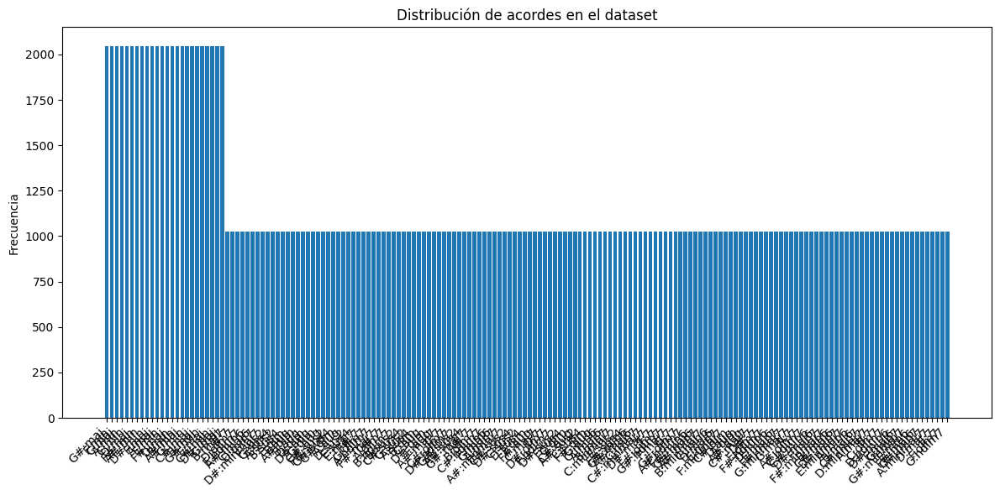

Acordes más frecuentes:
G#:maj   → 2048
F:min    → 2048
C:maj    → 2048
A:min    → 2048
C:min    → 2048
D:maj    → 2048
F#:min   → 2048
A#:min   → 2048
D#:min   → 2048
F:maj    → 2048
A:maj    → 2048
E:min    → 2048
F#:maj   → 2048
D:min    → 2048
B:min    → 2048
A#:maj   → 2048
G:min    → 2048
C#:maj   → 2048
B:maj    → 2048
G#:min   → 2048
E:maj    → 2048
C#:min   → 2048
D#:maj   → 2048
G:maj    → 2048
B:maj7   → 1024
C#:7     → 1024
D:dim7   → 1024
E:hdim7  → 1024
A#:min6  → 1024
C:maj6   → 1024
D:min7   → 1024
D#:minmaj7 → 1024
F:sus2   → 1024
G:sus4   → 1024
A:sus2   → 1024
B:sus4   → 1024
E:dim    → 1024
F:aug    → 1024
A#:dim   → 1024
B:aug    → 1024
D:dim    → 1024
D#:aug   → 1024
G:dim    → 1024
G#:aug   → 1024
F#:sus2  → 1024
G#:sus4  → 1024
G#:dim   → 1024
A:aug    → 1024
D:sus2   → 1024
E:sus4   → 1024
E:maj7   → 1024
F#:7     → 1024
G:dim7   → 1024
A:hdim7  → 1024
F#:maj7  → 1024
G#:7     → 1024
A:dim7   → 1024
B:hdim7  → 1024
B:sus2   → 1024
C#:sus4  → 1024
G:sus2   → 102

In [4]:
from pathlib import Path
import json
import collections
import matplotlib.pyplot as plt

def analyze_jams_chord_distribution(jams_folder: Path, top_k: int = None):
    """
    Visualiza la distribución de acordes (ej. 'A:min6') en archivos .jams de una carpeta.
    
    Args:
        jams_folder (Path): carpeta donde están los archivos .jams
        top_k (int): si se indica, muestra solo los K acordes más frecuentes
    """
    chord_counter = collections.Counter()
    jam_files = list(jams_folder.rglob("*.jams"))
    if not jam_files:
        print(f"[WARN] No hay archivos .jams en {jams_folder}")
        return

    # Recorremos cada archivo .jams
    for jam_path in jam_files:
        try:
            with open(jam_path, "r") as f:
                jam_data = json.load(f)
        except Exception as e:
            print(f"[ERROR] {jam_path.name} no se pudo leer: {e}")
            continue

        # Buscar anotaciones en namespace 'chord'
        annotations = jam_data.get("annotations", [])
        for ann in annotations:
            if ann.get("namespace") == "chord":
                for entry in ann.get("data", []):
                    chord = entry.get("value")
                    if chord:
                        chord_counter[chord] += 1

    if not chord_counter:
        print("[INFO] No se encontraron acordes.")
        return

    # Ordenar por frecuencia
    sorted_items = chord_counter.most_common(top_k)

    labels = [label for label, _ in sorted_items]
    counts = [count for _, count in sorted_items]

    # Plot
    plt.figure(figsize=(12, 6))
    bars = plt.bar(labels, counts)
    plt.title("Distribución de acordes en el dataset")
    plt.ylabel("Frecuencia")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

    # Mostrar valores
    print("Acordes más frecuentes:")
    for label, count in sorted_items:
        print(f"{label:8s} → {count}")

# Ejemplo de uso
JAMS_FOLDER = Path("/home/cepatinog/MIR/final_project/chord_progression_generator/data/jams")  # <--- CAMBIA ESTA RUTA
analyze_jams_chord_distribution(JAMS_FOLDER, top_k=168)


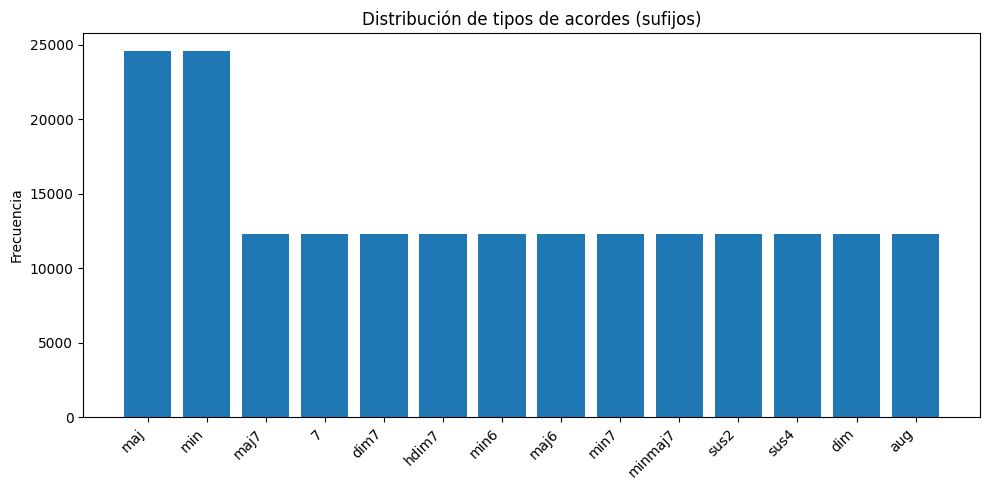

Tipos de acorde más frecuentes:
maj      → 24576
min      → 24576
maj7     → 12288
7        → 12288
dim7     → 12288
hdim7    → 12288
min6     → 12288
maj6     → 12288
min7     → 12288
minmaj7  → 12288
sus2     → 12288
sus4     → 12288
dim      → 12288
aug      → 12288


In [5]:
from pathlib import Path
import json
import collections
import matplotlib.pyplot as plt

def analyze_jams_suffix_distribution(jams_folder: Path, top_k: int = None):
    """
    Visualiza la distribución de tipos de acordes (ej. 'min', 'maj7') en archivos .jams.

    Args:
        jams_folder (Path): Carpeta donde están los archivos .jams
        top_k (int): Si se indica, muestra solo los K sufijos más frecuentes
    """
    suffix_counter = collections.Counter()
    jam_files = list(jams_folder.rglob("*.jams"))
    if not jam_files:
        print(f"[WARN] No hay archivos .jams en {jams_folder}")
        return

    for jam_path in jam_files:
        try:
            with open(jam_path, "r") as f:
                jam_data = json.load(f)
        except Exception as e:
            print(f"[ERROR] {jam_path.name} no se pudo leer: {e}")
            continue

        annotations = jam_data.get("annotations", [])
        for ann in annotations:
            if ann.get("namespace") == "chord":
                for entry in ann.get("data", []):
                    full_chord = entry.get("value")
                    if full_chord and ":" in full_chord:
                        _, suffix = full_chord.split(":", 1)  # p.ej. "A:min7" -> "min7"
                        suffix_counter[suffix] += 1

    if not suffix_counter:
        print("[INFO] No se encontraron acordes.")
        return

    # Ordenar y seleccionar top_k
    sorted_items = suffix_counter.most_common(top_k)

    labels = [label for label, _ in sorted_items]
    counts = [count for _, count in sorted_items]

    # Gráfico
    plt.figure(figsize=(10, 5))
    plt.bar(labels, counts)
    plt.title("Distribución de tipos de acordes (sufijos)")
    plt.ylabel("Frecuencia")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

    # Mostrar valores en texto
    print("Tipos de acorde más frecuentes:")
    for label, count in sorted_items:
        print(f"{label:8s} → {count}")

# Ejemplo de uso:
JAMS_FOLDER = Path("/home/cepatinog/MIR/final_project/chord_progression_generator/data/jams")  # <-- CAMBIA ESTA RUTA
analyze_jams_suffix_distribution(JAMS_FOLDER, top_k=20)


In [7]:
midi_folder_all_1 = MIDI_DIR
convert_all_mid_in_folder(midi_folder_all_1)

print("Archivos .wav creados en data/wav/")

Playing /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/vi,sus2-vii,sus4-I,maj-vi,min/E-3-vi,sus2-vii,sus4-I,maj-vi,min-150.mid
MIDI file: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/vi,sus2-vii,sus4-I,maj-vi,min/E-3-vi,sus2-vii,sus4-I,maj-vi,min-150.mid
Format: 1  Tracks: 2  Divisions: 960
Playing time: ~9 seconds
Notes cut: 0
Notes lost totally: 0
Convertido: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/vi,sus2-vii,sus4-I,maj-vi,min/E-3-vi,sus2-vii,sus4-I,maj-vi,min-150.mid => /home/cepatinog/MIR/final_project/chord_progression_generator/data/wav/E-3-vi,sus2-vii,sus4-I,maj-vi,min-150.wav
Playing /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/vi,sus2-vii,sus4-I,maj-vi,min/G-4-vi,sus2-vii,sus4-I,maj-vi,min-203.mid
MIDI file: /home/cepatinog/MIR/final_project/chord_progression_generator/data/midi/vi,sus2-vii,sus4-I,maj-vi,min/G-4-vi,sus2-vii,sus4-I,maj-vi,min-203.mid
Format: 1  Tracks